In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from PIL import Image

In [2]:
import pyEulerCurves as pyecc

# 1-parameter ECC

## Simple 1-parameter test

In [ ]:
test = np.array([[0, 1, 1], [1, 99, 1], [1, 2, 2]])
test

In [ ]:
%%time
trans = pyecc.ECC_from_bitmap(workers=2)  # number of CPU cores
ecc = trans.fit_transform(test) # in the 1-parameter case, fit_transform returns the ECC

In [ ]:
# this is the ECC
print(ecc)

In [ ]:
%%time
trans = pyecc.ECC_from_bitmap(workers=1, slicesize=2,  OLD=False)  # number of CPU cores
ecc = trans.fit_transform(test) # in the 1-parameter case, fit_transform returns the ECC

print(ecc)

In [ ]:
print(ecc)

In [ ]:
%%time
trans = pyecc.ECC_from_bitmap(workers=1, slicesize=3,  OLD=False)  # number of CPU cores
ecc = trans.fit_transform(test) # in the 1-parameter case, fit_transform returns the ECC

print(ecc)

In [ ]:
print(ecc)

In [ ]:
%%time
trans = pyecc.ECC_from_bitmap(workers=1, slicesize=4,  OLD=False)  # number of CPU cores
ecc = trans.fit_transform(test) # in the 1-parameter case, fit_transform returns the ECC

print(ecc)

In [ ]:
print(ecc)

In [ ]:
%%time
trans = pyecc.ECC_from_bitmap(workers=1, slicesize=50,  OLD=False)  # number of CPU cores
ecc = trans.fit_transform(test) # in the 1-parameter case, fit_transform returns the ECC

print(ecc)

In [ ]:
print(ecc)

In [ ]:
# and we can access the list of contributions
trans.contributions_list

## Grayscale image

In [ ]:
image_plank = Image.open("data/Planck.png")
plank_np = np.uint8(image_plank)  # convert it to unsigned int
print(plank_np.shape)
image_plank

In [ ]:
%%time
trans = pyecc.ECC_from_bitmap(workers=1, slicesize=50, OLD=False)  # number of CPU cores
ecc = trans.fit_transform(plank_np)

In [ ]:
%%time
transB = pyecc.ECC_from_bitmap(workers=1, slicesize=5000, OLD=False)  # number of CPU cores
eccB = transB.fit_transform(plank_np)

In [ ]:
len(transB.contributions_list)

In [ ]:
len(trans.contributions_list)

In [ ]:
np.inf in [trans.contributions_list[-1][0]]

In [ ]:
for i in range(164):
    if trans.contributions_list[i] != transB.contributions_list[i]:
        print(i, trans.contributions_list[i], transB.contributions_list[i])

In [ ]:
plank_np[499, 999]

In [ ]:
# plot the ECC
fig, axs = plt.subplots(1)

im0 = pyecc.plot_euler_curve(ecc, axs, with_lines=True)
axs.set_title("Planck")
plt.show()

In [ ]:
# load the ECC computed by CHUNKYeuler and check if they are equal
# https://bitbucket.org/hubwag/chunkyeuler/src/master/

ch_ECC = pd.read_csv(
    "data/Planck_t_u8_500x1000.raw.euler", sep=" ", header=None
).values.astype(float)

assert pyecc.difference_ECC(ecc, ch_ECC, max_f=256) == 0

# Multiparameter ECP

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from PIL import Image

In [4]:
import pyEulerCurves as pyecc

## Simple 2-parameter test

In [ ]:
test_2d = np.array(
    [[[0, 0], [1, 1], [1, 1]], [[1, 1], [9, 7], [1, 1]], [[1, 1], [1, 1], [1, 1]]]
)
print(test_2d.shape)

In [ ]:
%%time
trans = pyecc.ECC_from_bitmap(multifiltration=True, workers=1)
ecc = trans.fit_transform(test_2d) # when multifiltration=True fit_transform does not return the ecc
print(ecc)

In [ ]:
# but we can still access the list of contributions
trans.contributions_list

## RGB image

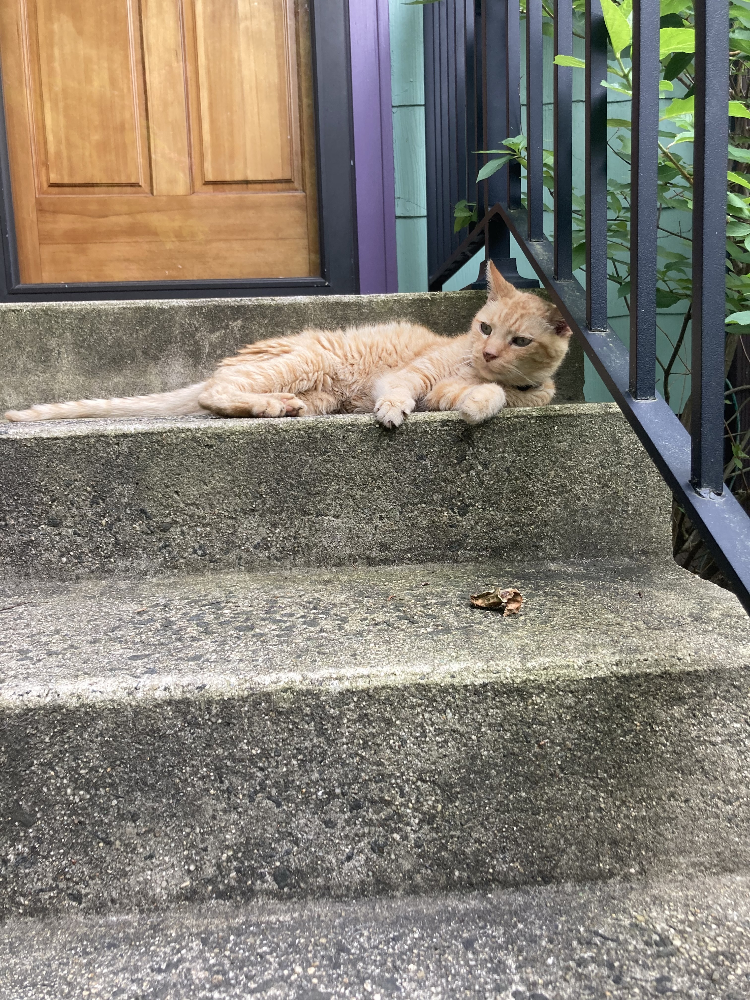

In [5]:
# this is Tigger, he is a good boi
cat = Image.open("data/tigger.jpg")
cat

In [6]:
cat_np = np.float16(
    cat
)  # converting to float because I want to pad with np.inf which doesn't work for uint
cat_np.shape

(4032, 3024, 3)

In [7]:
%%time
trans = pyecc.ECC_from_bitmap(multifiltration=True, workers=1, chunksize=100)
trans.fit_transform(cat_np)

(12201840, 3)
Parallel part done
Elapsed time: 50.4 seconds
Merged 4034 dicts
Elapsed time: 8.6 seconds
CPU times: user 14.8 s, sys: 3.34 s, total: 18.1 s
Wall time: 59.5 s


In [8]:
%%time
trans = pyecc.ECC_from_bitmap(multifiltration=True, workers=1, OLD=False, chunksize=100, slicesize=1000)
trans.fit_transform(cat_np)

(12201840, 3)
[[3024, 1000], [3024, 1000], [3024, 1000], [3024, 1000], [3024, 39]]
Parallel part done
Elapsed time: 53.9 seconds
Merged 5 dicts
Elapsed time: 18.9 seconds
CPU times: user 18.7 s, sys: 8.71 s, total: 27.4 s
Wall time: 1min 13s


In [9]:
%%time
trans = pyecc.ECC_from_bitmap(multifiltration=True, workers=1, OLD=False, chunksize=100, slicesize=10000)
trans.fit_transform(cat_np)

(12201840, 3)
[[3024, 4035]]
Parallel part done
Elapsed time: 53.7 seconds
Merged 1 dicts
Elapsed time: 18.7 seconds
CPU times: user 18.9 s, sys: 9.76 s, total: 28.7 s
Wall time: 1min 14s


In [10]:
# let's compare the performance to the pure python version
from RGBcubical_utils import compute_RGB_contributions

In [11]:
%%time
pyecp = compute_RGB_contributions(cat_np)

CPU times: user 1min 6s, sys: 105 ms, total: 1min 6s
Wall time: 1min 6s


In [13]:
## check that the output is the same
cecp = sorted(trans.contributions_list, key=lambda x: x[0])
cecp = np.array([[*c, v] for c, v in cecp])
print(cecp.shape)

pureecp = np.array([[*c, v] for c, v in pyecp])
print(pureecp.shape)

assert (cecp == pureecp).all()

(236652, 4)
(236652, 4)


In [14]:
cecp[-1]

array([255., 255., 255., 238.])

## Random RGB image

In [ ]:
# a large 5000x5000 rgb image
random_rgb = np.random.randint(0, 256, (1000, 1000, 3), dtype=np.uint8)
random_rgb = random_rgb.astype(np.float16)
random_rgb.shape

In [ ]:
%%time
trans = pyecc.ECC_from_bitmap(multifiltration=True, workers=1, chunksize=500, OLD=False, slicesize=100)
trans.fit_transform(random_rgb)

In [ ]:
%%time
trans = pyecc.ECC_from_bitmap(multifiltration=True, workers=1, chunksize=500, OLD=False, slicesize=1000)
trans.fit_transform(random_rgb)

In [ ]:
%%time
trans = pyecc.ECC_from_bitmap(multifiltration=True, workers=1, chunksize=500, OLD=False, slicesize=5000)
trans.fit_transform(random_rgb)

In [ ]:
%%time
pyecp = compute_RGB_contributions(random_rgb)

In [ ]:
## check that the output is the same
cecp = sorted(trans.contributions_list, key=lambda x: x[0])
cecp = np.array([[*c, v] for c, v in cecp])
print(cecp.shape)

purepy = np.array([[*c, v] for c, v in pyecp])
print(purepy.shape)

assert (cecp == purepy).all()

In [ ]:
%%time
trans = pyecc.ECC_from_bitmap(multifiltration=True, workers=1, chunksize=500)
trans.fit_transform(random_rgb)

In [ ]:
a = [i for i in range(0, 9)]
a

In [ ]:
s = 4

[
    a[i : i + s]
    for i in range(
        0,
        len(a),
        s - 1,
    )
]

In [ ]:
ids = [i for i in range(0, len(a) - s + 1, s - 1)]
ids

In [ ]:
len(a[ids[-1] + s :])

In [ ]:
a[ids[-1] + s - 1 :]

In [ ]:
len(a) % (s)